In [1]:
import libfmp.c1
import pretty_midi
import pandas as pd
from matplotlib import pyplot as plt
from matplotlib import patches
from matplotlib import colors
import IPython.display as ipd

# Single instrument

In [2]:
drums = pretty_midi.PrettyMIDI('Drums.mid')
drums_list = []

for instrument in drums.instruments:
    for note in instrument.notes:
        start = note.start
        end = note.end
        pitch = note.pitch
        velocity = note.velocity
        drums_list.append([start, end, pitch, velocity, instrument.name])
        
drums_list = sorted(drums_list, key=lambda x: (x[0], x[2]))

df = pd.DataFrame(drums_list, columns=['Inicio', 'Fin', 'Tono', 'Velocidad', 'Instrumento'])
df

,Inicio,Fin,Tono,Velocidad,Instrumento
0,0.000000,0.827586,36,95,
1,0.000000,0.827586,57,95,
2,0.827586,1.655172,44,95,
3,1.655172,2.482758,36,95,
4,1.655172,2.482758,49,95,
...,...,...,...,...,...
1890,167.673976,167.743743,36,95,
1891,167.743743,168.022812,38,95,
1892,167.743743,168.022812,57,95,
1893,168.022812,169.139088,36,111,


In [18]:
audio_drums = drums.synthesize(fs=44100)
ipd.Audio(audio_drums, rate=44100)

In [41]:
def midi_to_list(midi_data):
    midi_list = []
    pitch_list = []
    for instrument in midi_data.instruments:
        for note in instrument.notes:
            start = note.start
            end = note.end
            pitch = note.pitch
            velocity = note.velocity
            midi_list.append([start, end-start, pitch, velocity/128., instrument.name])
            pitch_list.append(pitch)
            
    return midi_list, pitch_list

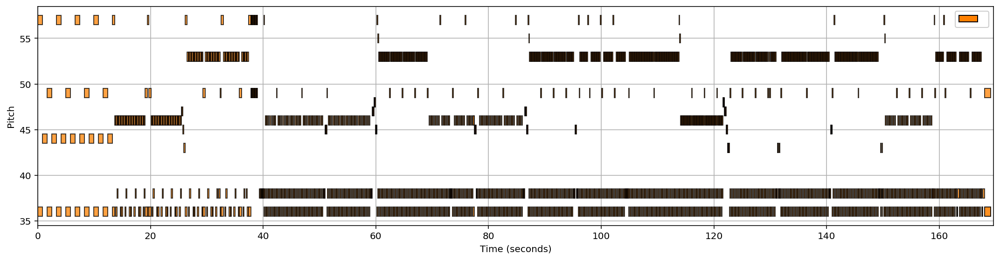

In [42]:
ddrums, drums_pitch = midi_to_list(drums)
libfmp.c1.visualize_piano_roll(ddrums, figsize=(15, 4), velocity_alpha=True);

In [50]:
ddrums

[[0.0, 0.827586, 57, 0.7421875, ''],
 [0.0, 0.827586, 36, 0.7421875, ''],
 [0.827586, 0.827586, 44, 0.7421875, ''],
 [1.655172, 0.8275859999999999, 49, 0.7421875, ''],
 [1.655172, 0.8275859999999999, 36, 0.7421875, ''],
 [2.482758, 0.8275860000000002, 44, 0.7421875, ''],
 [3.310344, 0.8275859999999997, 57, 0.7421875, ''],
 [3.310344, 0.8275859999999997, 36, 0.7421875, ''],
 [4.13793, 0.8275860000000002, 44, 0.7421875, ''],
 [4.965516, 0.8275860000000002, 49, 0.7421875, ''],
 [4.965516, 0.8275860000000002, 36, 0.7421875, ''],
 [5.793102, 0.8275860000000002, 44, 0.7421875, ''],
 [6.620688, 0.8275860000000002, 57, 0.7421875, ''],
 [6.620688, 0.8275860000000002, 36, 0.7421875, ''],
 [7.4482740000000005, 0.8275859999999993, 44, 0.7421875, ''],
 [8.27586, 0.8275860000000002, 49, 0.7421875, ''],
 [8.27586, 0.8275860000000002, 36, 0.7421875, ''],
 [9.103446, 0.8275860000000002, 44, 0.7421875, ''],
 [9.931032, 0.8275860000000002, 57, 0.7421875, ''],
 [9.931032, 0.8275860000000002, 36, 0.7421875

In [49]:
drums_pitch

[57,
 36,
 44,
 49,
 36,
 44,
 57,
 36,
 44,
 49,
 36,
 44,
 57,
 36,
 44,
 49,
 36,
 44,
 57,
 36,
 44,
 49,
 36,
 44,
 57,
 36,
 46,
 46,
 36,
 46,
 38,
 46,
 46,
 46,
 36,
 46,
 36,
 46,
 46,
 46,
 36,
 46,
 38,
 46,
 46,
 46,
 36,
 46,
 36,
 46,
 46,
 46,
 36,
 46,
 38,
 46,
 46,
 46,
 36,
 46,
 36,
 46,
 46,
 46,
 36,
 46,
 38,
 49,
 36,
 57,
 36,
 49,
 36,
 46,
 46,
 36,
 46,
 38,
 46,
 46,
 46,
 36,
 46,
 36,
 46,
 46,
 46,
 36,
 46,
 38,
 46,
 46,
 46,
 36,
 46,
 36,
 46,
 46,
 46,
 36,
 46,
 38,
 46,
 46,
 46,
 36,
 46,
 36,
 46,
 46,
 46,
 36,
 46,
 38,
 47,
 47,
 45,
 43,
 57,
 36,
 53,
 53,
 36,
 53,
 38,
 53,
 53,
 53,
 36,
 53,
 36,
 53,
 53,
 53,
 36,
 53,
 38,
 53,
 53,
 53,
 36,
 49,
 36,
 53,
 53,
 36,
 53,
 38,
 53,
 53,
 53,
 36,
 53,
 36,
 53,
 53,
 53,
 36,
 53,
 38,
 53,
 53,
 38,
 49,
 36,
 57,
 36,
 53,
 53,
 36,
 53,
 38,
 53,
 53,
 53,
 36,
 53,
 36,
 53,
 53,
 53,
 36,
 53,
 38,
 53,
 53,
 53,
 36,
 49,
 36,
 53,
 53,
 36,
 53,
 38,
 53,
 53,
 38,
 53,
 36,


# All Instruments

In [43]:
EvD = pretty_midi.PrettyMIDI('EvilDead.mid')
evd_list, evd_pitch = midi_to_list(EvD)
audio_evd = EvD.synthesize(fs=22050)
ipd.Audio(audio_evd, rate=22050)

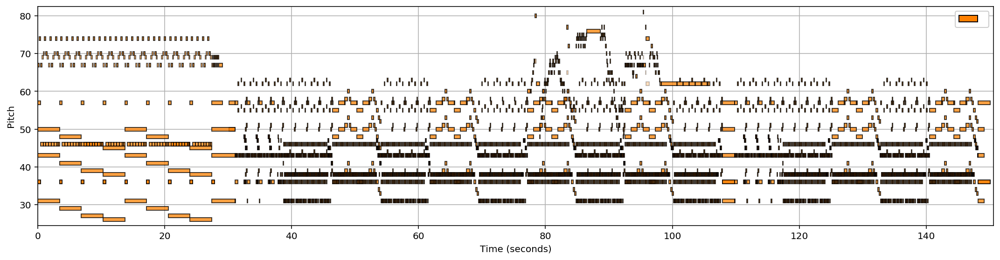

In [44]:
libfmp.c1.visualize_piano_roll(evd_list, figsize=(15, 4), velocity_alpha=True);

### Using all instruments doesnt work very well because the program doesnt separate each instrument

# Understanding J.S. Bach Chorales dataset with a single example.
In the book Generative Deep Learning Teaching Machines to Paint, Write Compose and Play the author shows a processed data from the data set.


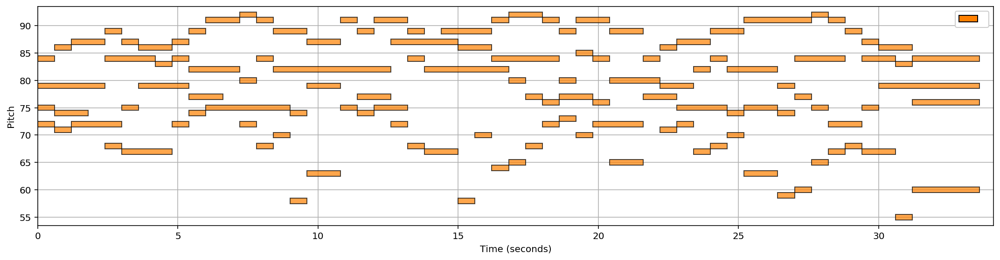

In [45]:
chor = pretty_midi.PrettyMIDI('BachChorales.mid')
chor_list, pitch_list = midi_to_list(chor)
libfmp.c1.visualize_piano_roll(chor_list, figsize=(15, 4), velocity_alpha=True);

In [35]:
chor.instruments

[Instrument(program=0, is_drum=False, name="")]

In [37]:
chor_list

[[0.0, 0.6, 72, 0.703125, ''],
 [0.0, 0.6, 75, 0.703125, ''],
 [0.0, 0.6, 84, 0.703125, ''],
 [0.6, 0.6, 71, 0.703125, ''],
 [0.6, 0.6, 86, 0.703125, ''],
 [0.6, 1.2000000000000002, 74, 0.703125, ''],
 [0.0, 2.4, 79, 0.703125, ''],
 [1.2, 1.2, 87, 0.703125, ''],
 [2.4, 0.6000000000000001, 68, 0.703125, ''],
 [1.2, 1.8, 72, 0.703125, ''],
 [2.4, 0.6000000000000001, 89, 0.703125, ''],
 [3.0, 0.6000000000000001, 75, 0.703125, ''],
 [3.0, 0.6000000000000001, 87, 0.703125, ''],
 [2.4, 1.8000000000000003, 84, 0.703125, ''],
 [3.0, 1.7999999999999998, 67, 0.703125, ''],
 [4.2, 0.5999999999999996, 83, 0.703125, ''],
 [3.6, 1.1999999999999997, 86, 0.703125, ''],
 [4.8, 0.6000000000000005, 72, 0.703125, ''],
 [3.6, 1.8000000000000003, 79, 0.703125, ''],
 [4.8, 0.6000000000000005, 84, 0.703125, ''],
 [4.8, 0.6000000000000005, 87, 0.703125, ''],
 [5.4, 0.5999999999999996, 74, 0.703125, ''],
 [5.4, 0.5999999999999996, 89, 0.703125, ''],
 [5.4, 1.2000000000000002, 77, 0.703125, ''],
 [5.4, 1.7999999

In [51]:
pitch_list

[72,
 75,
 84,
 71,
 86,
 74,
 79,
 87,
 68,
 72,
 89,
 75,
 87,
 84,
 67,
 83,
 86,
 72,
 79,
 84,
 87,
 74,
 89,
 77,
 82,
 91,
 72,
 80,
 92,
 68,
 84,
 91,
 70,
 75,
 58,
 74,
 89,
 63,
 79,
 87,
 75,
 91,
 74,
 89,
 77,
 82,
 72,
 75,
 91,
 68,
 84,
 89,
 67,
 87,
 58,
 70,
 86,
 89,
 64,
 82,
 91,
 65,
 80,
 68,
 77,
 92,
 72,
 76,
 84,
 91,
 73,
 80,
 89,
 70,
 77,
 85,
 76,
 84,
 91,
 65,
 72,
 89,
 80,
 84,
 71,
 77,
 86,
 72,
 79,
 67,
 82,
 87,
 68,
 75,
 84,
 70,
 74,
 89,
 63,
 75,
 82,
 59,
 74,
 79,
 60,
 77,
 91,
 65,
 75,
 92,
 67,
 84,
 91,
 68,
 72,
 89,
 75,
 87,
 67,
 84,
 55,
 83,
 86,
 60,
 76,
 79,
 84]

In [59]:
EvD1 = pretty_midi.PrettyMIDI('Guitar1.mid')
evd_list, evd_pitch = midi_to_list(EvD)
audio_evd = EvD.synthesize(fs=22050)
ipd.Audio(audio_evd, rate=22050)

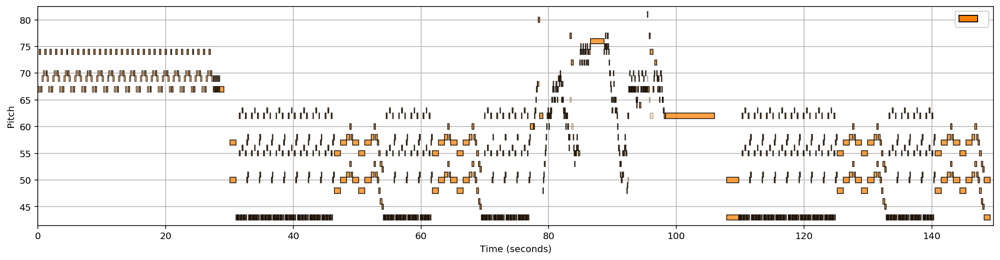

In [53]:
libfmp.c1.visualize_piano_roll(evd_list, figsize=(15, 4), velocity_alpha=True);

In [72]:
evd_list

[[0.0, 0.21428550000000002, 67, 0.7421875, ''],
 [0.21428550000000002, 0.21428550000000002, 74, 0.7421875, ''],
 [0.42857100000000004, 0.21428550000000002, 67, 0.7421875, ''],
 [0.6428565, 0.21428550000000002, 69, 0.546875, ''],
 [0.8571420000000001, 0.21428550000000013, 70, 0.546875, ''],
 [1.0714275000000002, 0.2142854999999999, 74, 0.7421875, ''],
 [1.285713, 0.21428550000000013, 70, 0.7421875, ''],
 [1.4999985000000002, 0.2142854999999999, 69, 0.546875, ''],
 [1.7142840000000001, 0.21428550000000013, 67, 0.546875, ''],
 [1.9285695000000003, 0.21428550000000013, 74, 0.7421875, ''],
 [2.1428550000000004, 0.2142854999999999, 67, 0.7421875, ''],
 [2.3571405000000003, 0.2142854999999999, 69, 0.546875, ''],
 [2.571426, 0.21428550000000035, 70, 0.546875, ''],
 [2.7857115000000006, 0.2142854999999999, 74, 0.7421875, ''],
 [2.9999970000000005, 0.2142854999999999, 70, 0.7421875, ''],
 [3.2142825000000004, 0.2142854999999999, 69, 0.546875, ''],
 [3.4285680000000003, 0.21428550000000035, 67, 0

In [ ]:
def time(midi):
    midi_list = []
    for instrument in midi_data.instruments:
        
    

In [73]:
def midi_to_list(midi_data):
    midi_list = []
    pitch_list = []
    for instrument in midi_data.instruments:
        for note.pitch in instrument.notes:
            start = note.start
            end = note.end
            pitch = note.pitch
            velocity = note.velocity
            midi_list.append([start, end-start, pitch, velocity/128])
            pitch_list.append(pitch)
            
    return midi_list, pitch_list

In [63]:
EvD1.get_piano_roll(fs=100, times=None, pedal_threshold=90)

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [77]:
import pandas as pd
df = pd.DataFrame(EvD1.get_piano_roll(fs=16, times=None, pedal_threshold=90))
df.head(128)

,0,1,2,3,4,5,6,7,8,9,...,2376,2377,2378,2379,2380,2381,2382,2383,2384,2385
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
124,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
125,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
126,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [78]:
evd_list[0]

[0.0, 0.21428550000000002, 67, 0.7421875, '']